In [1]:
0

0

In [1]:
# This cell contains the code from https://github.com/uncbiag/mermaid
# that defines the functions compute_warped_image_multiNC
# which we use for composing maps and identity_map_multiN which we use
# to get an identity map. 
import torch
from torch.autograd import Function
from torch.nn import Module
import random

def scale_map(map,spacing):
    """
    Scales the map to the [-1,1]^d format
    :param map: map in BxCxXxYxZ format
    :param spacing: spacing in XxYxZ format
    :return: returns the scaled map
    """
    sz = map.size()
    map_scaled = torch.zeros_like(map)
    ndim = len(spacing)

    # This is to compensate to get back to the [-1,1] mapping of the following form
    # id[d]*=2./(sz[d]-1)
    # id[d]-=1.

    for d in range(ndim):
        if sz[d+2] >1:
            map_scaled[:, d, ...] = map[:, d, ...] * (2. / (sz[d + 2] - 1.) / spacing[d]) - 1.
        else:
            map_scaled[:, d, ...] = map[:,d,...]

    return map_scaled

class STNFunction_ND_BCXYZ(Module):
    """
   Spatial transform function for 1D, 2D, and 3D. In BCXYZ format (this IS the format used in the current toolbox).
   """

    def __init__(self, spacing, zero_boundary = False,using_bilinear=True,using_01_input=True):
        """
        Constructor
        :param ndim: (int) spatial transformation of the transform
        """
        super(STNFunction_ND_BCXYZ, self).__init__()
        self.spacing = spacing
        self.ndim = len(spacing)
        #zero_boundary = False
        self.zero_boundary = 'zeros' if zero_boundary else 'border'
        self.mode = 'bilinear' if using_bilinear else 'nearest'
        self.using_01_input=using_01_input

    def forward_stn(self, input1, input2, ndim):
        if ndim==1:
            # use 2D interpolation to mimick 1D interpolation
            # now test this for 1D
            phi_rs = input2.reshape(list(input2.size()) + [1])
            input1_rs = input1.reshape(list(input1.size()) + [1])

            phi_rs_size = list(phi_rs.size())
            phi_rs_size[1] = 2

            phi_rs_ordered = torch.zeros(phi_rs_size,dtype=phi_rs.dtype,device=phi_rs.device)
            # keep dimension 1 at zero
            phi_rs_ordered[:, 1, ...] = phi_rs[:, 0, ...]

            output_rs = torch.nn.functional.grid_sample(input1_rs, phi_rs_ordered.permute([0, 2, 3, 1]), mode=self.mode, padding_mode=self.zero_boundary,align_corners=True)
            output = output_rs[:, :, :, 0]

        if ndim==2:
            # todo double check, it seems no transpose is need for 2d, already in height width design
            input2_ordered = torch.zeros_like(input2)
            input2_ordered[:,0,...] = input2[:,1,...]
            input2_ordered[:,1,...] = input2[:,0,...]
            output = torch.nn.functional.grid_sample(input1, input2_ordered.permute([0, 2, 3, 1]), mode=self.mode,
                                          padding_mode=self.zero_boundary,align_corners=True)
        if ndim==3:
            input2_ordered = torch.zeros_like(input2)
            input2_ordered[:, 0, ...] = input2[:, 2, ...]
            input2_ordered[:, 1, ...] = input2[:, 1, ...]
            input2_ordered[:, 2, ...] = input2[:, 0, ...]
            output = torch.nn.functional.grid_sample(input1, input2_ordered.permute([0, 2, 3, 4, 1]), mode=self.mode, padding_mode=self.zero_boundary,align_corners=True)
        return output

    def forward(self, input1, input2):
        """
        Perform the actual spatial transform
        :param input1: image in BCXYZ format
        :param input2: spatial transform in BdimXYZ format
        :return: spatially transformed image in BCXYZ format
        """

        assert(len(self.spacing)+2==len(input2.size()))
        if self.using_01_input:
            output = self.forward_stn(input1, scale_map(input2,self.spacing), self.ndim)
        else:
            output = self.forward_stn(input1, input2, self.ndim)
        # print(STNVal(output, ini=-1).sum())
        return output

class STN_ND_BCXYZ(Module):
    """
    Spatial transform code for nD spatial transoforms. Uses the BCXYZ image format.
    """
    def __init__(self, spacing, zero_boundary=False,use_bilinear=True,use_01_input=True,use_compile_version=False):
        super(STN_ND_BCXYZ, self).__init__()
        self.spacing = spacing
        """spatial dimension"""
        if use_compile_version:
            if use_bilinear:
                self.f = STNFunction_ND_BCXYZ_Compile(self.spacing,zero_boundary)
            else:
                self.f = partial(get_nn_interpolation,spacing = self.spacing)
        else:
            self.f = STNFunction_ND_BCXYZ( self.spacing,zero_boundary= zero_boundary,using_bilinear= use_bilinear,using_01_input = use_01_input)

        """spatial transform function"""
    def forward(self, input1, input2):
        """
       Simply returns the transformed input
       :param input1: image in BCXYZ format 
       :param input2: map in BdimXYZ format
       :return: returns the transformed image
       """
        return self.f(input1, input2)

def compute_warped_image_multiNC(I0, phi, spacing, spline_order, zero_boundary=False, use_01_input=True):
    """Warps image.
    :param I0: image to warp, image size BxCxXxYxZ
    :param phi: map for the warping, size BxdimxXxYxZ
    :param spacing: image spacing [dx,dy,dz]
    :return: returns the warped image of size BxCxXxYxZ
    """

    dim = I0.dim()-2
    if dim == 1:
        return _compute_warped_image_multiNC_1d(I0, phi, spacing, spline_order,zero_boundary,use_01_input=use_01_input)
    elif dim == 2:
        return _compute_warped_image_multiNC_2d(I0, phi, spacing, spline_order,zero_boundary,use_01_input=use_01_input)
    elif dim == 3:
        return _compute_warped_image_multiNC_3d(I0, phi, spacing, spline_order,zero_boundary,use_01_input=use_01_input)
    else:
        raise ValueError('Images can only be warped in dimensions 1 to 3')

def _compute_warped_image_multiNC_2d(I0, phi, spacing, spline_order,zero_boundary=False,use_01_input=True):

    if spline_order not in [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]:
        raise ValueError('Currently only orders 0 to 9 are supported')

    if spline_order == 0:
        stn = STN_ND_BCXYZ(spacing,
                           zero_boundary,
                           use_bilinear=False,
                           use_01_input=use_01_input)
    elif spline_order == 1:
        stn = STN_ND_BCXYZ(spacing,
                           zero_boundary,
                           use_bilinear=True,
                           use_01_input=use_01_input)
    else:
        stn = SplineInterpolation_ND_BCXYZ(spacing,
                                           spline_order)

    I1_warped = stn(I0, phi)

    return I1_warped
def identity_map_multiN(sz,spacing,dtype='float32'):
    """
    Create an identity map
    :param sz: size of an image in BxCxXxYxZ format
    :param spacing: list with spacing information [sx,sy,sz]
    :param dtype: numpy data-type ('float32', 'float64', ...)
    :return: returns the identity map
    """
    dim = len(sz)-2
    nrOfI = int(sz[0])

    if dim == 1:
        id = np.zeros([nrOfI,1,sz[2]],dtype=dtype)
    elif dim == 2:
        id = np.zeros([nrOfI,2,sz[2],sz[3]],dtype=dtype)
    elif dim == 3:
        id = np.zeros([nrOfI,3,sz[2],sz[3],sz[4]],dtype=dtype)
    else:
        raise ValueError('Only dimensions 1-3 are currently supported for the identity map')

    for n in range(nrOfI):
        id[n,...] = identity_map(sz[2::],spacing,dtype=dtype)

    return id
def identity_map(sz,spacing,dtype='float32'):
    """
    Returns an identity map.
    :param sz: just the spatial dimensions, i.e., XxYxZ
    :param spacing: list with spacing information [sx,sy,sz]
    :param dtype: numpy data-type ('float32', 'float64', ...)
    :return: returns the identity map of dimension dimxXxYxZ
    """
    dim = len(sz)
    if dim==1:
        id = np.mgrid[0:sz[0]]
    elif dim==2:
        id = np.mgrid[0:sz[0],0:sz[1]]
    elif dim==3:
        id = np.mgrid[0:sz[0],0:sz[1],0:sz[2]]
    else:
        raise ValueError('Only dimensions 1-3 are currently supported for the identity map')

    # now get it into range [0,(sz-1)*spacing]^d
    id = np.array( id.astype(dtype) )
    if dim==1:
        id = id.reshape(1,sz[0]) # add a dummy first index

    for d in range(dim):
        id[d]*=spacing[d]

        #id[d]*=2./(sz[d]-1)
        #id[d]-=1.

    # and now store it in a dim+1 array
    if dim==1:
        idnp = np.zeros([1, sz[0]], dtype=dtype)
        idnp[0,:] = id[0]
    elif dim==2:
        idnp = np.zeros([2, sz[0], sz[1]], dtype=dtype)
        idnp[0,:, :] = id[0]
        idnp[1,:, :] = id[1]
    elif dim==3:
        idnp = np.zeros([3,sz[0], sz[1], sz[2]], dtype=dtype)
        idnp[0,:, :, :] = id[0]
        idnp[1,:, :, :] = id[1]
        idnp[2,:, :, :] = id[2]
    else:
        raise ValueError('Only dimensions 1-3 are currently supported for the identity map')

    return idnp


In [3]:
#First, we download the MNIST dataset and store it as a dataset we can train against.

import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import torchvision
import matplotlib.pyplot as plt
import torch.optim as optim

def get_dataset(split):
    ds = torch.utils.data.DataLoader(
        torchvision.datasets.MNIST("./files/",
            transform=torchvision.transforms.ToTensor(),
            download=True,
            train=(split == "train")
        ),
        batch_size=500
    )
    images = []
    for _, batch in enumerate(ds):
        label = np.array(batch[1])
        batch_nines = label ==5
        images.append(np.array(batch[0])[batch_nines])
    images = np.concatenate(images)

    ds = torch.utils.data.TensorDataset(torch.Tensor(images))
    d1, d2 = (torch.utils.data.DataLoader(ds, batch_size=128, shuffle=True, ) for _ in (1,1))
    return d1, d2
d1_mnist, d2_mnist = get_dataset("train")
d1_mnist_test, d2_mnist_test = get_dataset("test")

In [4]:
 def get_dataset_triangles(split):
    x, y = np.mgrid[0:1:28j, 0:1:28j]
    x = np.reshape(x, (1, 28, 28))
    y = np.reshape(y, (1, 28, 28))
    cx = np.random.random((6000, 1, 1)) * .3 + .4
    cy = np.random.random((6000, 1, 1)) * .3 + .4
    r = np.random.random((6000, 1, 1)) * .2 + .2
    theta = np.random.random((6000, 1, 1)) * np.pi * 2
    isTriangle = np.random.random((6000, 1, 1)) > .5

    triangles = (np.sqrt((x - cx)**2 + (y - cy)**2) 
    - r * np.cos(np.pi / 3) / np.cos((np.arctan2(x - cx, y - cy) + theta) % (2 * np.pi / 3) - np.pi / 3))

    triangles = np.tanh(-40 * triangles)

    circles = np.tanh(-40 * (np.sqrt((x - cx)**2 + (y - cy)**2) - r) )
    
    images = isTriangle * triangles + (1 - isTriangle) * circles

    ds = torch.utils.data.TensorDataset(torch.Tensor(np.expand_dims(images, 1)))
    d1, d2 = (torch.utils.data.DataLoader(ds, batch_size=128, shuffle=True, ) for _ in (1,1))
    return d1, d2

d1_triangles, d2_triangles = get_dataset_triangles("train")
d1_triangles_test, d2_triangles_test = get_dataset_triangles("test")

In [5]:
#Next, we define the neural network architectures that we will pair with our
#inverse consistency loss

class Autoencoder(nn.Module):
    def __init__(self, num_layers, channels):
        super(Autoencoder, self).__init__()
        self.num_layers = num_layers
        down_channels = channels[0]
        up_channels = channels[1]
        self.downConvs = nn.ModuleList([])
        self.upConvs = nn.ModuleList([])
        for depth in range(self.num_layers):
            self.downConvs.append( 
                nn.Conv2d(
                    down_channels[depth], 
                    down_channels[depth + 1],
                    kernel_size=3,
                    padding=1,
                    stride=2
                )
            )
            self.upConvs.append(
                nn.ConvTranspose2d(
                    up_channels[depth + 1], 
                    up_channels[depth],
                    kernel_size=4,
                    padding=1,
                    stride=2
                )
            )
        self.lastConv = nn.Conv2d(
            16, 2, kernel_size=3, padding=1)
        torch.nn.init.zeros_(self.lastConv.weight)
     
    def forward(self, x, y):
        x = torch.cat([x, y], 1)
        skips = []
        for depth in range(self.num_layers):
            skips.append(x)
            x = F.relu(self.downConvs[depth](x))
        for depth in reversed(range(self.num_layers)):
            x = F.relu(self.upConvs[depth](x))
            x = x[:, :, :skips[depth].size()[2], :skips[depth].size()[3]]
        x = self.lastConv(x)
        return x / 10

def tallAE():
    return Autoencoder(5, np.array([
        [2, 16, 32, 64, 256, 512],
        [16, 32, 64, 128, 256, 512],
    ]))


class UNet(nn.Module):
    def __init__(self, num_layers, channels):
        super(UNet, self).__init__()
        self.num_layers = num_layers
        down_channels = channels[0]
        up_channels_out = channels[1]
        up_channels_in = channels[2]
        self.downConvs = nn.ModuleList([])
        self.upConvs = nn.ModuleList([])
        self.batchNorms = nn.ModuleList(
            [nn.BatchNorm2d(num_features = up_channels_out[_])
             for _ in range(self.num_layers)])
        for depth in range(self.num_layers):
            self.downConvs.append( 
                nn.Conv2d(
                    down_channels[depth], 
                    down_channels[depth + 1],
                    kernel_size=3,
                    padding=1,
                    stride=2
                )
            )
            self.upConvs.append(
                nn.ConvTranspose2d(
                    up_channels_in[depth], 
                    up_channels_out[depth],
                    kernel_size=4,
                    padding=1,
                    stride=2
                )
            )
        self.lastConv = nn.Conv2d(
            18, 2, kernel_size=3, padding=1)
        torch.nn.init.zeros_(self.lastConv.weight)
     
    def forward(self, x, y):
        x = torch.cat([x, y], 1)
        skips = []
        for depth in range(self.num_layers):
            skips.append(x)
            x = F.relu(self.downConvs[depth](x))
        for depth in reversed(range(self.num_layers)):
            x = F.relu(self.upConvs[depth](x))
            x = self.batchNorms[depth](x)
            
            x = x[:, :, :skips[depth].size()[2], :skips[depth].size()[3]]
            x = torch.cat([x, skips[depth]], 1)
        x = self.lastConv(x)
        return x / 10
    
def tallUNet():
    return UNet(5, np.array([
        [2, 16, 32, 64, 256, 512],
        [16, 32, 64, 128, 256],
        [48, 96, 192, 512, 512]
    ]))


class RegisNet(nn.Module):
    def __init__(self):
        super(RegisNet, self).__init__()
        self.conv1 = nn.Conv2d(2, 10, kernel_size=5, padding=2)
        self.conv2 = nn.Conv2d(12, 10, kernel_size=5, padding=2)
        self.conv3 = nn.Conv2d(22, 10, kernel_size=5, padding=2)
        self.conv4 = nn.Conv2d(32, 10, kernel_size=5, padding=2)
        self.conv5 = nn.Conv2d(42, 10, kernel_size=5, padding=2)
        self.conv6 = nn.Conv2d(52, 2, kernel_size=5, padding=2)

    def forward(self, x, y):
        x= torch.cat([x, y], 1)
        
        x = torch.cat([x, F.relu(self.conv1(x))], 1)
        x = torch.cat([x, F.relu(self.conv2(x))], 1)
        x = torch.cat([x, F.relu(self.conv3(x))], 1)
        x = torch.cat([x, F.relu(self.conv4(x))], 1)
        x = torch.cat([x, F.relu(self.conv5(x))], 1)
        
        return self.conv6(x)
    
class FCNet(nn.Module):
    def __init__(self):
        super(FCNet, self).__init__()
        self.dense1 = nn.Linear(28 * 28 * 2, 8000)
        self.dense2 = nn.Linear(8000, 3000)
        self.dense3 = nn.Linear(3000, 28 * 28 * 2)
        torch.nn.init.zeros_(self.dense3.weight)
    def forward(self, x, y):
        x = torch.reshape(torch.cat([x, y], 1), (-1, 2 * 28 * 28))
        x = F.relu(self.dense1(x))
        x = F.relu(self.dense2(x))
        x = self.dense3(x)
        x = torch.reshape(x, (-1, 2, 28, 28))
        return x
        
#Here we define our inverse consistency loss

class InverseConsistentNet(nn.Module):
    def __init__(self, network, lmbda):
        super(InverseConsistentNet, self).__init__()       
        
        self.sz = np.array([128, 1, 28, 28])
        self.spacing = 1./(self.sz[2::]-1) 
        
        _id = identity_map_multiN(self.sz, self.spacing)
        self.identityMap = torch.from_numpy(_id).cuda()

        self.regis_net = network().cuda()
        self.lmbda = lmbda
        
        self.random_sampling=True
        

    def forward(self, image_A, image_B):
        

        self.D_AB = self.regis_net(image_A, image_B) 
        self.phi_AB = self.D_AB + self.identityMap
        
        self.D_BA = self.regis_net(image_B, image_A)
        self.phi_BA = self.D_BA + self.identityMap
        
        self.warped_image_A = compute_warped_image_multiNC(
            image_A, self.phi_AB, self.spacing, 1)
        
        self.warped_image_B = compute_warped_image_multiNC(
            image_B, self.phi_BA, self.spacing, 1)
        
        Iepsilon = self.identityMap + torch.randn(128, 2, 28, 28).cuda() * 1/28
        
        D_BA_epsilon = compute_warped_image_multiNC(self.D_BA, Iepsilon, self.spacing, 1)
        
        

        self.approximate_identity = compute_warped_image_multiNC( 
                self.D_AB, D_BA_epsilon + Iepsilon, self.spacing, 1
            ) + D_BA_epsilon

        inverse_consistency_loss = self.lmbda * torch.mean(
                (self.approximate_identity)**2
        )
        similarity_loss = (
            torch.mean((self.warped_image_A - image_B)**2) + 
            torch.mean((self.warped_image_B - image_A)**2)
        )
        transform_magnitude= self.lmbda * torch.mean(
            (self.identityMap - self.phi_AB)**2
        )
        self.all_loss =  inverse_consistency_loss + similarity_loss
        return [x.item() for x in (inverse_consistency_loss, similarity_loss, transform_magnitude)]
        
        



In [27]:
def train(net, d1, d2, epochs=400):
  optimizer = torch.optim.Adam(net.parameters(), lr=.0001)
  net.train()
  loss_history = []
  print("[", end="")
  for epoch in range(epochs):
      print("-", end="")
      if (epoch + 1) % 50 == 0:
        print("]", end="\n[")
      for A, B in list(zip(d1, d2)):
          if A[0].size()[0] == 128:
              image_A = A[0].cuda()
              image_B = B[0].cuda()
              optimizer.zero_grad()
              inverse_consistency_loss, similarity_loss, transform_magnitude = net(
                  image_A, image_B)

              
              loss = net.all_loss
              loss.backward()
              optimizer.step()
      du = (net.phi_AB[:, :, 1:, :-1] 
            - net.phi_AB[:, :, :-1, :-1]).detach().cpu()
      dv = (net.phi_AB[:, :, :-1, 1:] 
            - net.phi_AB[:, :, :-1, :-1]).detach().cpu()
      dA = du[:, 0] * dv[:, 1] - du[:, 1] * dv[:, 0]

      loss_history.append([inverse_consistency_loss, 
                          similarity_loss,
                          transform_magnitude, torch.log(torch.sum(dA < 0) + 0.1)])
  print("]")
  return loss_history

In [15]:
def show_as_grid(phi):
    plot_phi = 28 * phi.detach().cpu() - .5
    axes = plt.gca()
    axes.set_xlim([-.5,27.5])
    axes.set_ylim([27.5,-.5])
    plt.plot(plot_phi[1], plot_phi[0], linewidth=.3)
    plt.plot(plot_phi[1].transpose(0, 1), plot_phi[0].transpose(0, 1), linewidth=.3)



def visualizeRegistration(net, image_A, image_B, N):

    net(image_A, image_B)
    du = (net.phi_AB[:, :, 1:, :-1] - net.phi_AB[:, :, :-1, :-1]).detach().cpu()
    dv = (net.phi_AB[:, :, :-1, 1:] - net.phi_AB[:, :, :-1, :-1]).detach().cpu()
    dA = du[:, 0] * dv[:, 1] - du[:, 1] * dv[:, 0]
    
    plt.figure(dpi=400)
    plt.subplot(2, 2, 1)
    ax = plt.gca()
    ax.axes.xaxis.set_ticks([])
    ax.axes.yaxis.set_ticks([])

    plt.title("Image A")
    plt.imshow(image_A[N, 0].cpu())
    plt.subplot(2, 2, 2)
    ax = plt.gca()
    ax.axes.xaxis.set_ticks([])
    ax.axes.yaxis.set_ticks([])
    plt.title("Image B Warped")
    plt.imshow(net.warped_image_B.detach().cpu()[N, 0])
    show_as_grid(net.phi_AB[N])
    plt.subplot(2, 2, 3)
    ax = plt.gca()
    ax.axes.xaxis.set_ticks([])
    ax.axes.yaxis.set_ticks([])
    plt.title("Image B")
    plt.imshow(image_B[N, 0].cpu())
    
    plt.subplot(2, 2, 4)
    ax = plt.gca()
    ax.set_aspect("equal")
    ax.axes.xaxis.set_ticks([])
    ax.axes.yaxis.set_ticks([])
    plt.title("Composition of Transforms")
    show_as_grid((compute_warped_image_multiNC(net.D_BA, net.phi_AB, net.spacing, 1) + net.phi_AB)[N])
    plt.show()
    
    plt.title("Area form of PhiAB")
    plt.imshow(dA[N])
    plt.colorbar()
    plt.show()

    print("Diffeomorphism Failures per batch")
    print(torch.sum(dA < 0))
    

def visualizeRegistrationCompact(net, image_A, image_B, N):

    net(image_A, image_B)
    du = (net.phi_AB[:, :, 1:, :-1] - net.phi_AB[:, :, :-1, :-1]).detach().cpu()
    dv = (net.phi_AB[:, :, :-1, 1:] - net.phi_AB[:, :, :-1, :-1]).detach().cpu()
    dA = du[:, 0] * dv[:, 1] - du[:, 1] * dv[:, 0]
    
    
    ax = plt.gca()
    ax.axes.xaxis.set_ticks([])
    ax.axes.yaxis.set_ticks([])
    #plt.title("Image B Warped")
    plt.imshow(net.warped_image_B.detach().cpu()[N, 0])
    show_as_grid(net.phi_AB[N])
    
    

<function tallUNet at 0x7f60a04e0830> 512
[-

/playpen-raid1/tgreer/anaconda3/envs/mermaid4/lib/python3.7/site-packages/ipykernel_launcher.py:108: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


-------------------------------------------------]
[--------------------------------------------------]
[]


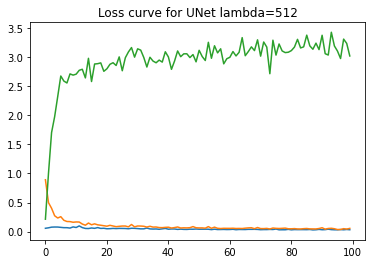

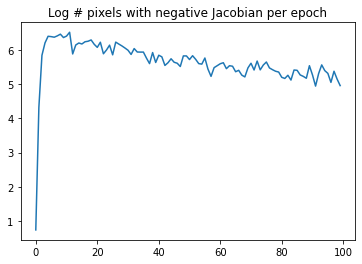

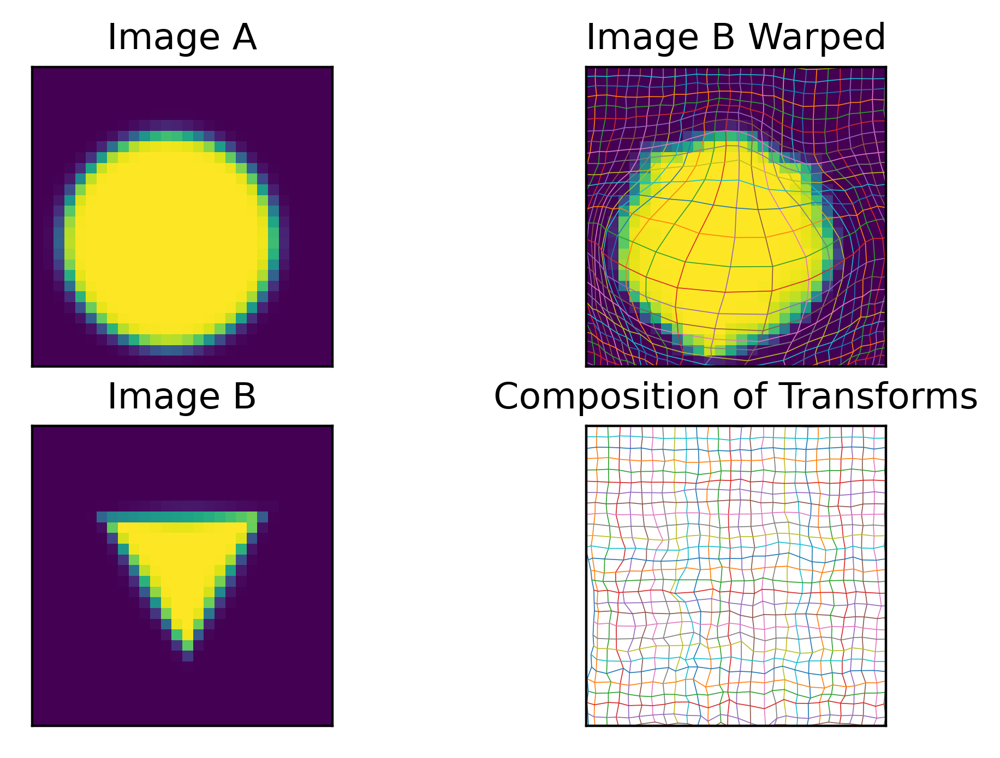

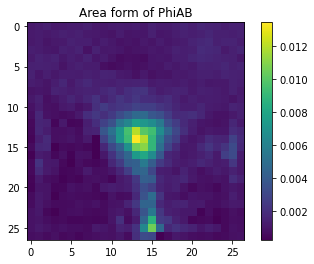

Diffeomorphism Failures per batch
tensor(150)


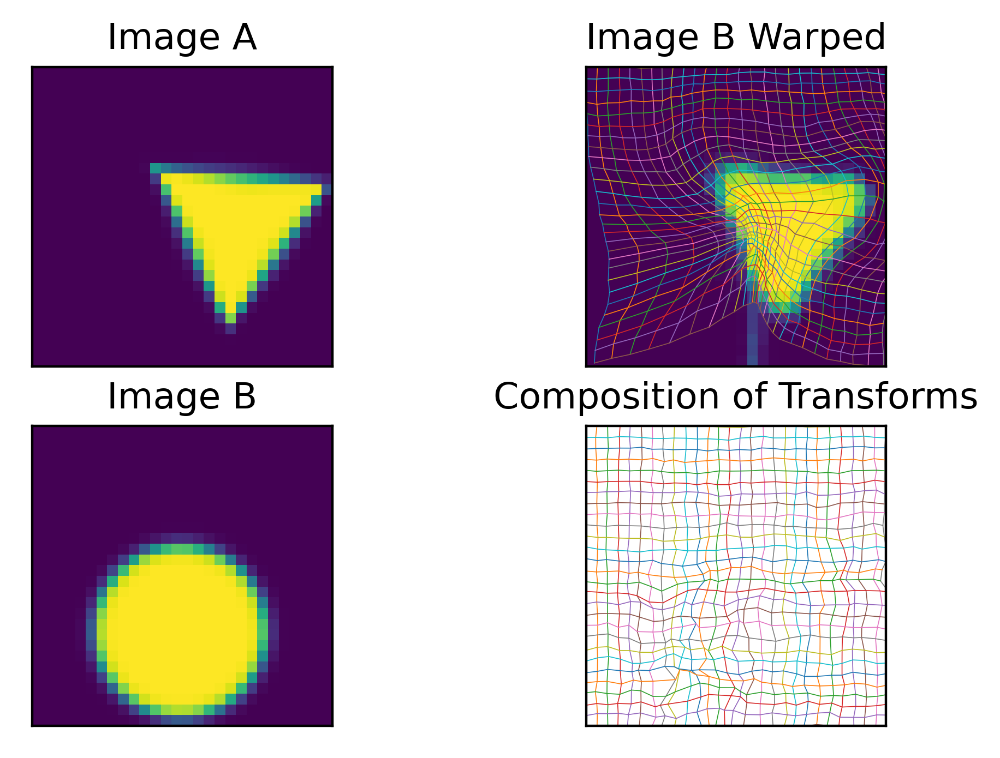

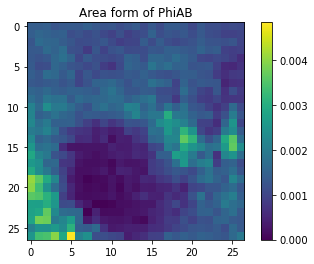

Diffeomorphism Failures per batch
tensor(150)


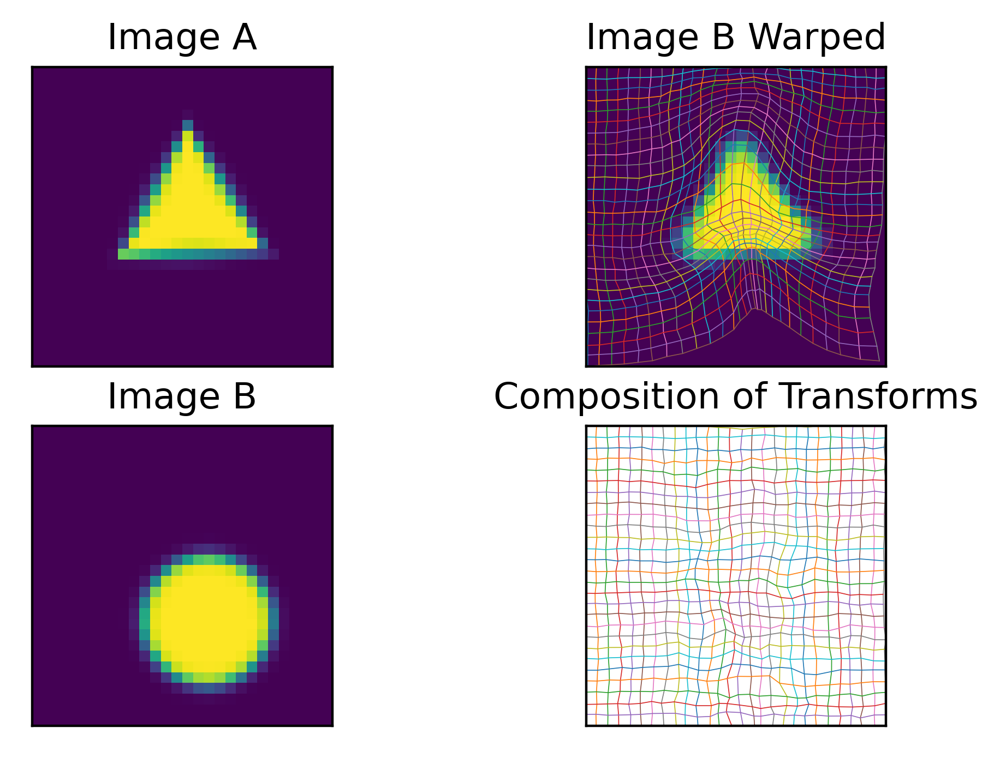

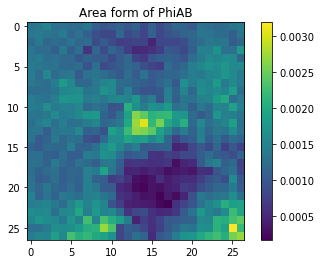

Diffeomorphism Failures per batch
tensor(150)


In [39]:
network=tallUNet
d1, d2, d1_t, d2_t =(d1_triangles, d2_triangles, d1_triangles_test, d2_triangles_test)
lmbda=512
random.seed(1)
torch.manual_seed(1)
torch.cuda.manual_seed(1)
np.random.seed(1)
print("=" * 50)
print(network, lmbda)
net = InverseConsistentNet(network, lmbda)
x = np.array(train(net, d1, d2, epochs=100))

plt.title("Loss curve for " + type(net.regis_net).__name__ + " lambda=" + str(lmbda))
plt.plot(x[:, :3])
plt.show()
plt.title("Log # pixels with negative Jacobian per epoch")
plt.plot(x[:, 3])
plt.show()
random.seed(1)
torch.manual_seed(1)
torch.cuda.manual_seed(1)
np.random.seed(1)
image_A, image_B = (x[0].cuda() for x in next(zip(d1_t, d2_t)))
for N in range(3):
 visualizeRegistration(net, image_A, image_B, N)

In [ ]:
networks = [FCNet, tallAE, tallUNet, RegisNet]

datasets = [(d1_mnist, d2_mnist, d1_mnist_test, d2_mnist_test), 
            (d1_triangles, d2_triangles, d1_triangles_test, d2_triangles_test)]

lambdas = [0, 32, 64, 128, 256, 512, 1024, 2048]

import random
for network in networks:
    for d1, d2, d1_t, d2_t in datasets:
        for lmbda in lambdas:
            random.seed(1)
            torch.manual_seed(1)
            torch.cuda.manual_seed(1)
            np.random.seed(1)
            print("=" * 50)
            print(type(net.regis_net).__name__, lmbda)
            net = InverseConsistentNet(network, lmbda)
            x = np.array(train(net, d1, d2))

            plt.title("Loss curve for " + type(net.regis_net).__name__ + " lambda=" + str(lmbda))
            plt.plot(x[:, :3])
            plt.show()
            plt.title("Log # pixels with negative Jacobian per epoch")
            plt.plot(x[:, 3])
            plt.show()
            random.seed(1)
            torch.manual_seed(1)
            torch.cuda.manual_seed(1)
            np.random.seed(1)
            image_A, image_B = (x[0].cuda() for x in next(zip(d1_t, d2_t)))
            for N in range(3):
                visualizeRegistration(net, image_A, image_B, N)



<class '__main__.FCNet'> 0
[--------------------------------------------------]
[--------------------------------------------------]
[--------------------------------------------------]
[--------------------------------------------------]
[--------------------------------------------------]
[--------------------------------------------------]
[--------------------------------------------------]
[--------------------------------------------------]
[]


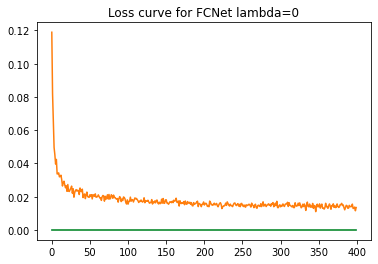

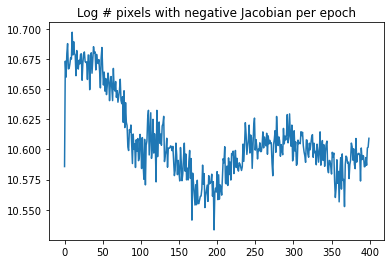

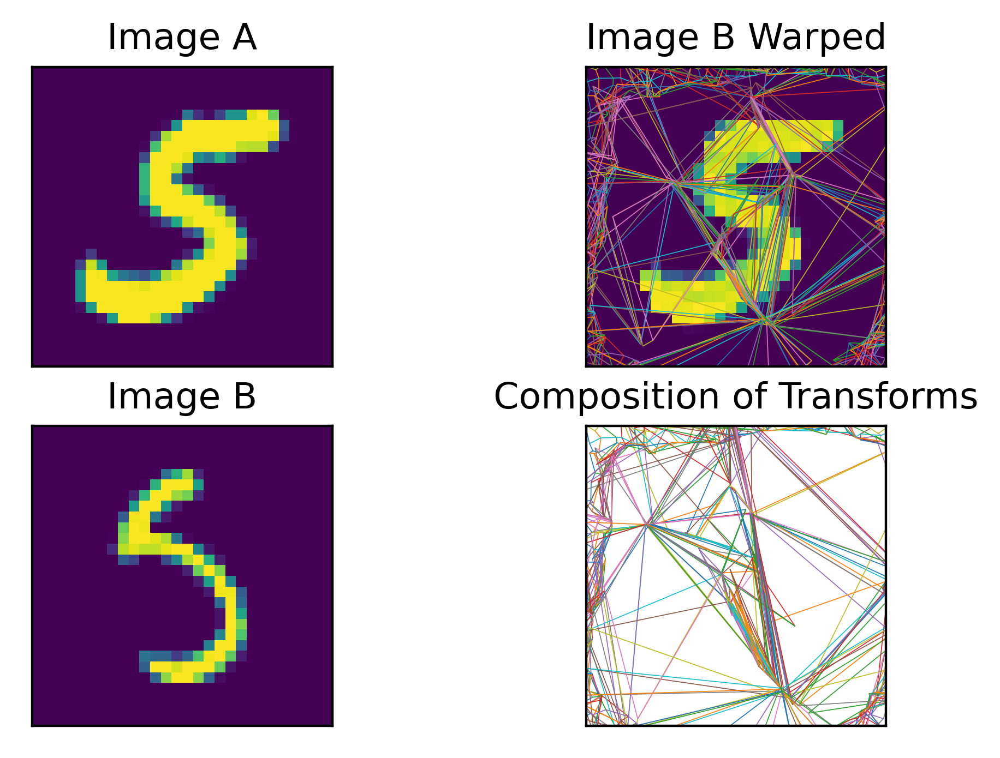

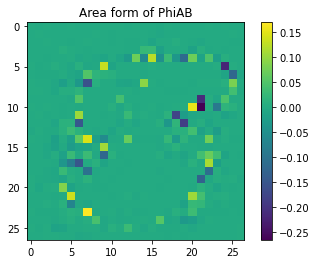

Diffeomorphism Failures per batch
tensor(39804)


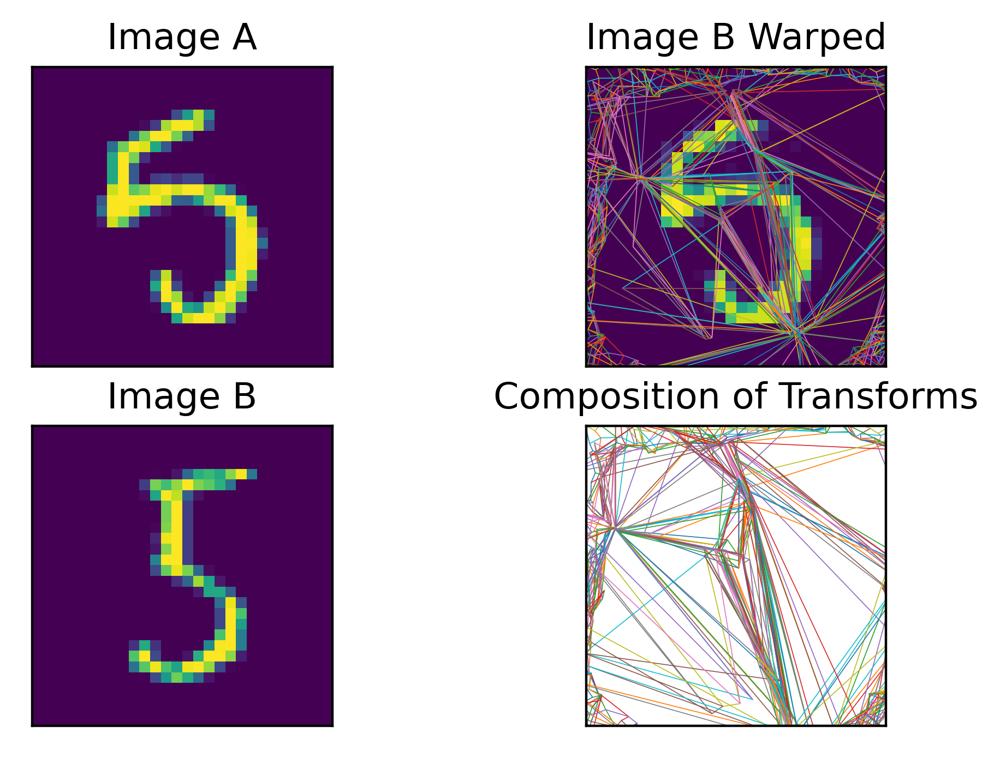

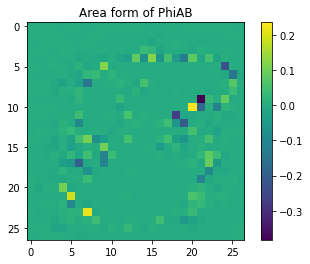

Diffeomorphism Failures per batch
tensor(39804)


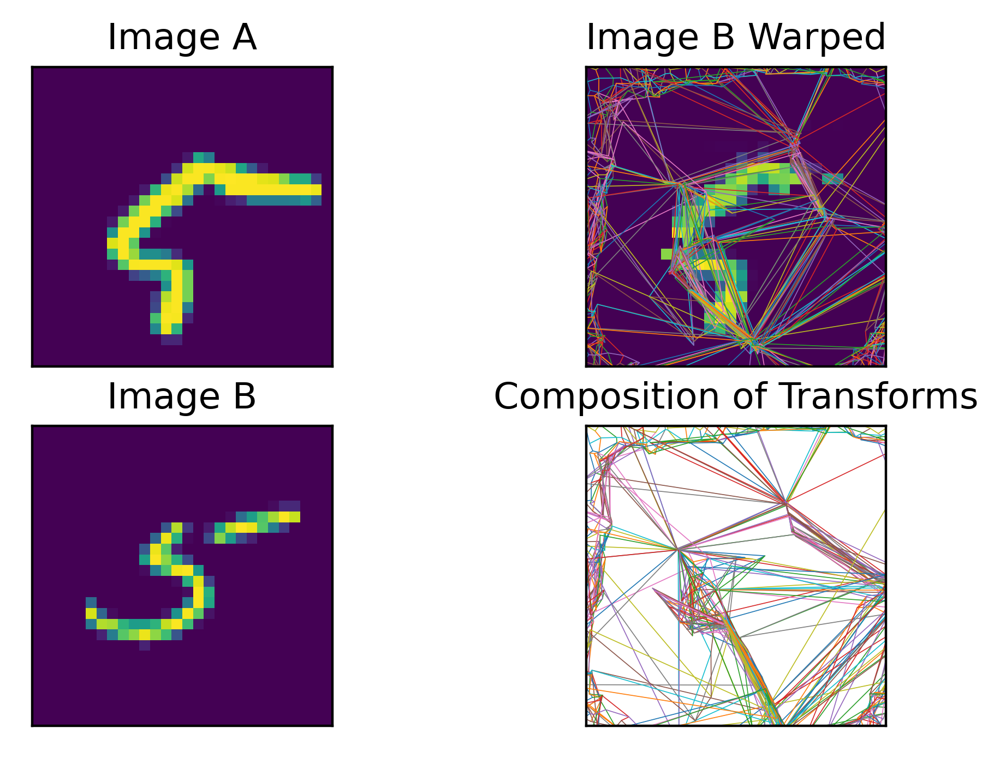

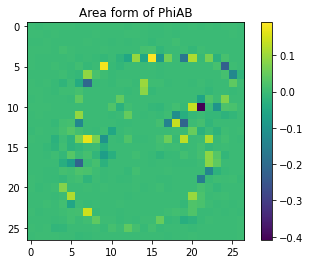

Diffeomorphism Failures per batch
tensor(39804)
<class '__main__.FCNet'> 64
[--------------------------------------------------]
[--------------------------------------------------]
[--------------------------------------------------]
[--------------------------------------------------]
[--------------------------------------------------]
[--------------------------------------------------]
[-----------

In [ ]:
networks = [FCNet, tallAE, tallUNet, RegisNet]

datasets = [("mnist", d1_mnist, d2_mnist, d1_mnist_test, d2_mnist_test), 
            ("triangles", d1_triangles, d2_triangles, d1_triangles_test, d2_triangles_test)]

lambdas = [0, 64, 128, 256, 512, 1024, 2048]

results = {}

import random
for network in networks:
    for dname, d1, d2, d1_t, d2_t in datasets:
         for lmbda in lambdas:
             random.seed(1)
             torch.manual_seed(1)
             torch.cuda.manual_seed(1)
             np.random.seed(1)
             print("=" * 50)
             print(network, lmbda)
             net = InverseConsistentNet(network, lmbda)
             x = np.array(train(net, d1, d2))
             
             plt.title("Loss curve for " + type(net.regis_net).__name__ + " lambda=" + str(lmbda))
             plt.plot(x[:, :3])
             plt.show()
             plt.title("Log # pixels with negative Jacobian per epoch")
             plt.plot(x[:, 3])
             plt.show()

             random.seed(1)
             torch.manual_seed(1)
             torch.cuda.manual_seed(1)
             np.random.seed(1)
             image_A, image_B = (x[0].cuda() for x in next(zip(d1_t, d2_t)))
             for N in range(3):
                 visualizeRegistration(net, image_A, image_B, N)
             results[(type(net.regis_net).__name__, dname, lmbda)] = (
                 net.state_dict(),
                 x
             )
             with open("results/" + str((type(net.regis_net).__name__, dname, lmbda)), "wb") as f:
                    pickle.dump((net.state_dict(), x), f)


In [ ]:
net.state_dict()

In [ ]:
import pickle
with open("allnetwork_results.pickle" , "wb") as f:
    pickle.dump(results, f)

In [ ]:
def get_dataset_lump(split):
    x, y = np.mgrid[0:1:28j, 0:1:28j]
    x = np.reshape(x, (1, 28, 28))
    y = np.reshape(y, (1, 28, 28))
    cx = np.random.random((6000, 1, 1)) * .2 + .4
    cy = np.random.random((6000, 1, 1)) * .2 + .4
    r = np.random.random((6000, 1, 1)) * .2 + .2
    theta = np.random.random((6000, 1, 1)) * np.pi * 2
    isTriangle = np.random.random((6000, 1, 1)) > .5

    triangles = (np.sqrt((x - cx)**2 + (y - cy)**2) 
    - r * np.cos(np.pi / 3) / np.cos((np.arctan2(x - cx, y - cy) + theta) % (2 * np.pi / 3) - np.pi / 3))

    triangles = np.tanh(-40 * triangles)

    circles = np.tanh(-40 * (np.sqrt((x - cx)**2 + (y - cy)**2) - r) )
    
    images = isTriangle * triangles + (1 - isTriangle) * circles

    ds = torch.utils.data.TensorDataset(torch.Tensor(np.expand_dims(images, 1)))
    d1, d2 = (torch.utils.data.DataLoader(ds, batch_size=128, shuffle=True, ) for _ in (1,1))
    return d1, d2

d1_triangles, d2_triangles = get_dataset_triangles("train")
d1_triangles_test, d2_triangles_test = get_dataset_triangles("test")

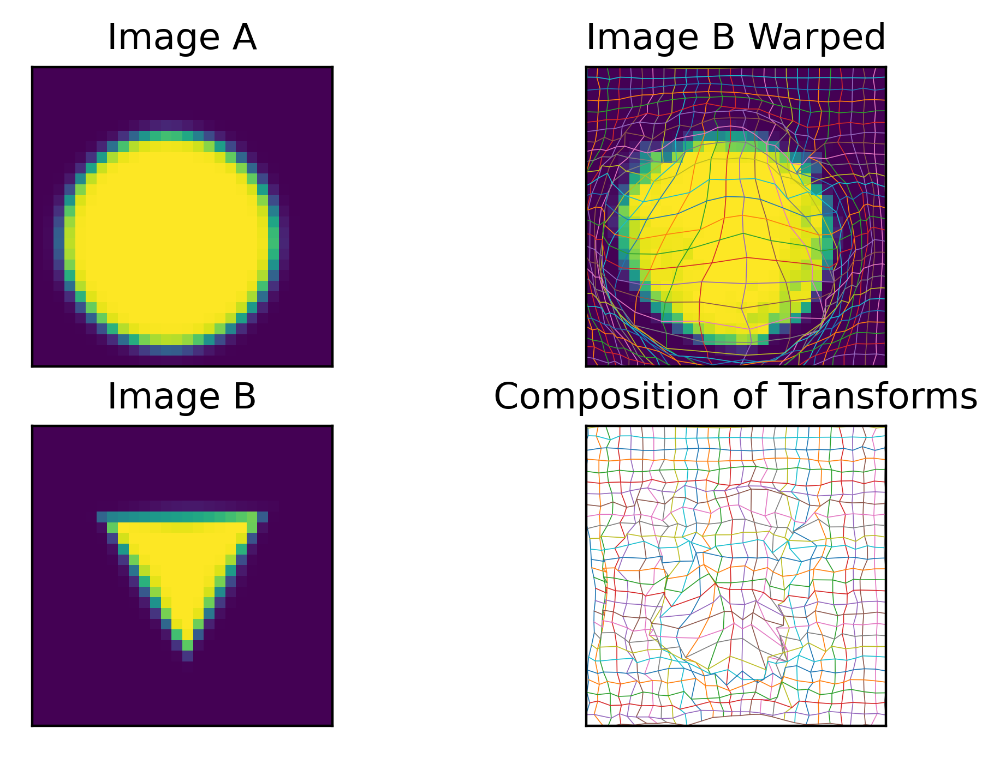

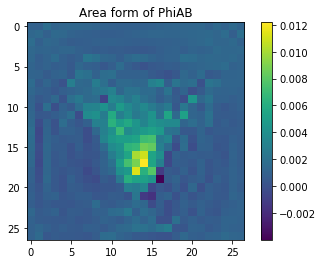

Diffeomorphism Failures per batch
tensor(2324)


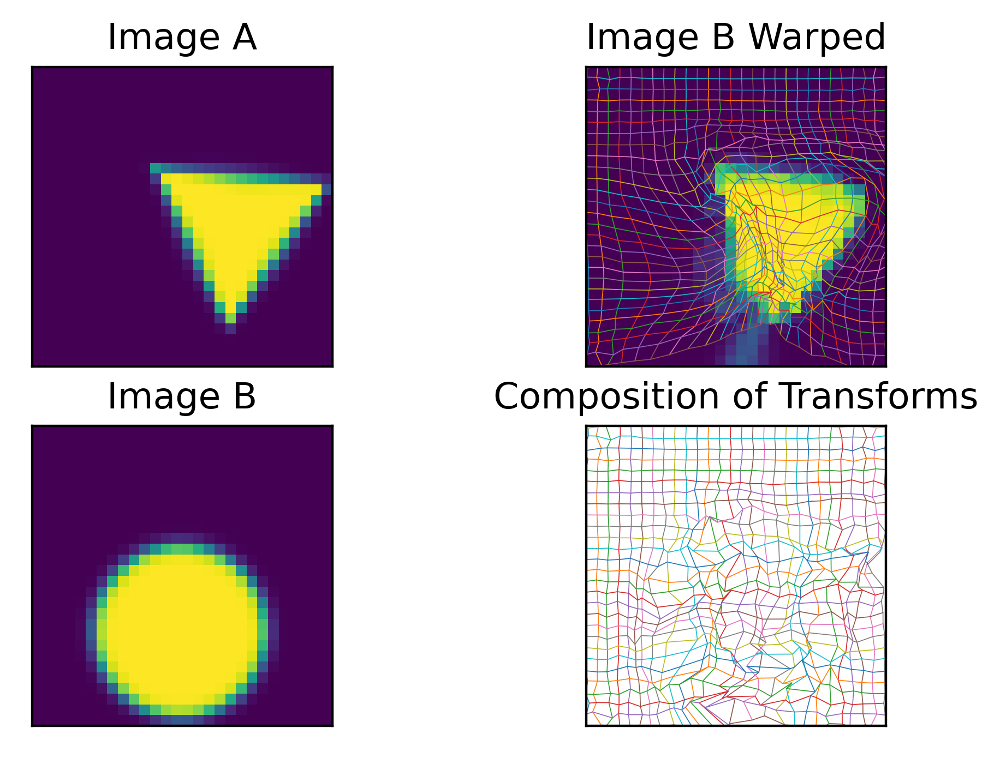

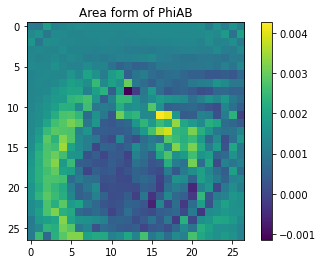

Diffeomorphism Failures per batch
tensor(2324)


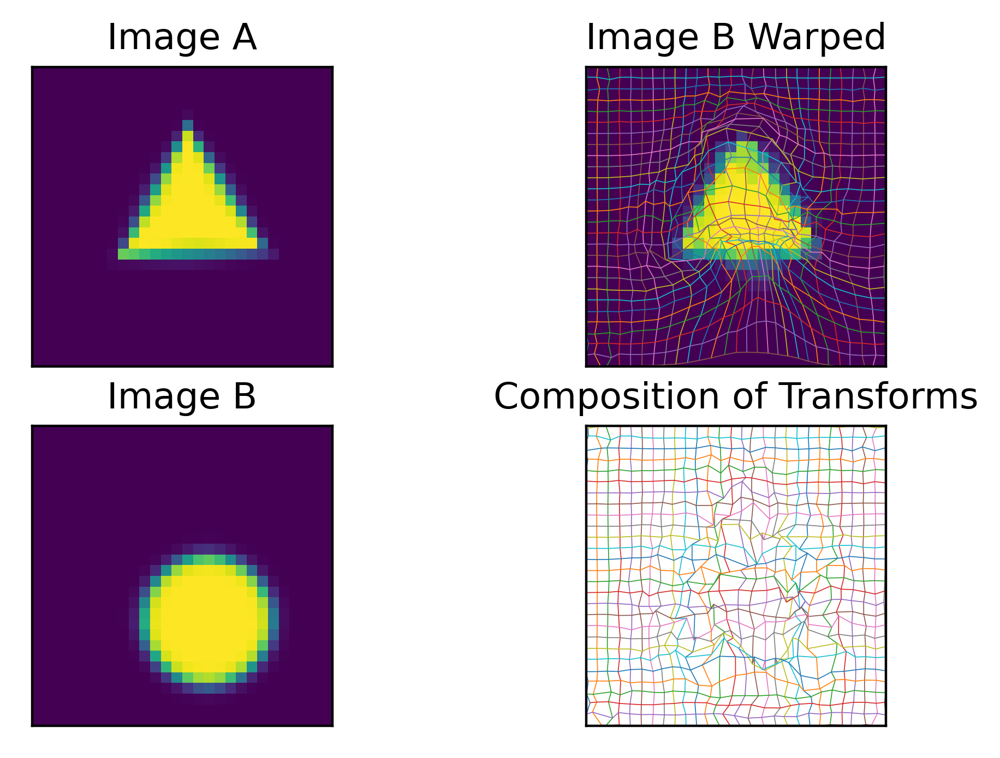

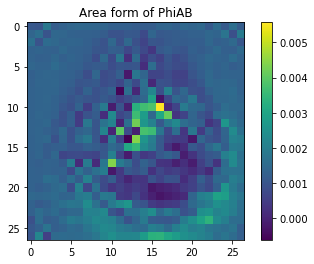

Diffeomorphism Failures per batch
tensor(2324)


In [37]:
for N in range(3):
 visualizeRegistration(net, image_A, image_B, N)

In [40]:
mkdir results

In [9]:
import pickle
import os
keys = os.listdir("results")

In [10]:
len(keys)

56

In [13]:
def loadd(name):
    print(name)
    with open("results/" + name, "rb") as f:
        return pickle.load(f)
all_results = {name: loadd(name) for name in keys}

('FCNet', 'mnist', 0)
('FCNet', 'mnist', 64)
('FCNet', 'mnist', 128)
('FCNet', 'mnist', 256)
('FCNet', 'mnist', 512)
('FCNet', 'mnist', 1024)
('FCNet', 'mnist', 2048)
('FCNet', 'triangles', 0)
('FCNet', 'triangles', 64)
('FCNet', 'triangles', 128)
('FCNet', 'triangles', 256)
('FCNet', 'triangles', 512)
('FCNet', 'triangles', 1024)
('FCNet', 'triangles', 2048)
('Autoencoder', 'mnist', 0)
('Autoencoder', 'mnist', 64)
('Autoencoder', 'mnist', 128)
('Autoencoder', 'mnist', 256)
('Autoencoder', 'mnist', 512)
('Autoencoder', 'mnist', 1024)
('Autoencoder', 'mnist', 2048)
('Autoencoder', 'triangles', 0)
('Autoencoder', 'triangles', 64)
('Autoencoder', 'triangles', 128)
('Autoencoder', 'triangles', 256)
('Autoencoder', 'triangles', 512)
('Autoencoder', 'triangles', 1024)
('Autoencoder', 'triangles', 2048)
('UNet', 'mnist', 0)
('UNet', 'mnist', 64)
('UNet', 'mnist', 128)
('UNet', 'mnist', 256)
('UNet', 'mnist', 512)
('UNet', 'mnist', 1024)
('UNet', 'mnist', 2048)
('UNet', 'triangles', 0)
('UNet'

/playpen-raid1/tgreer/anaconda3/envs/mermaid4/lib/python3.7/site-packages/ipykernel_launcher.py:108: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
/playpen-raid1/tgreer/anaconda3/envs/mermaid4/lib/python3.7/site-packages/ipykernel_launcher.py:108: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
/playpen-raid1/tgreer/anaconda3/envs/mermaid4/lib/python3.7/site-packages/ipykernel_launcher.py:108: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) 

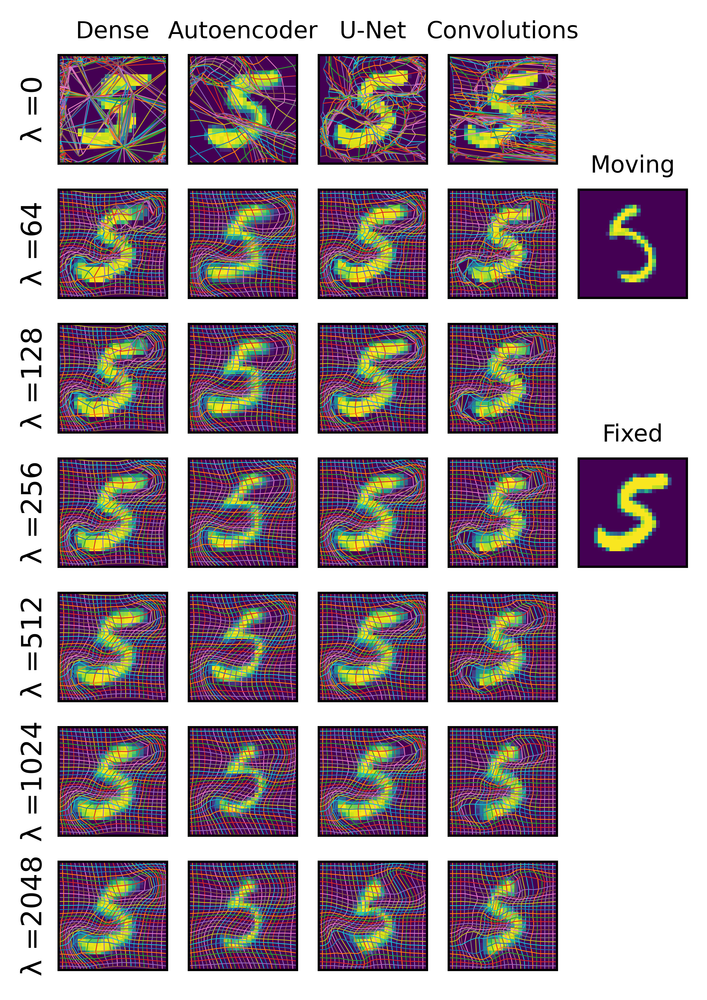

/playpen-raid1/tgreer/anaconda3/envs/mermaid4/lib/python3.7/site-packages/ipykernel_launcher.py:108: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
/playpen-raid1/tgreer/anaconda3/envs/mermaid4/lib/python3.7/site-packages/ipykernel_launcher.py:108: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
/playpen-raid1/tgreer/anaconda3/envs/mermaid4/lib/python3.7/site-packages/ipykernel_launcher.py:108: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) 

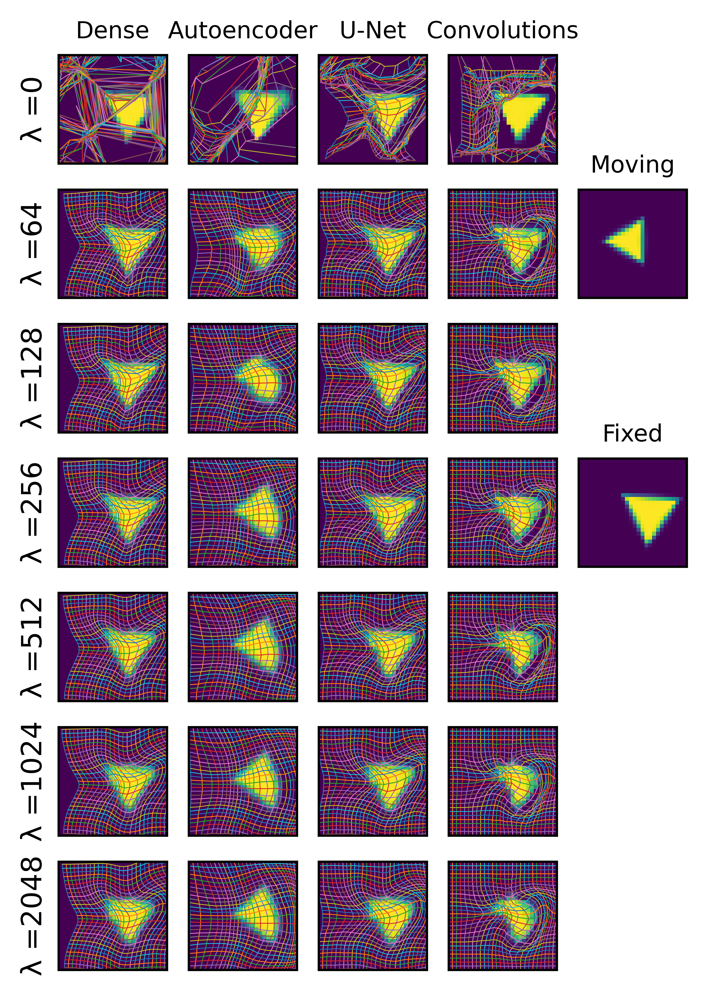

In [37]:
networks = [FCNet, tallAE, tallUNet, RegisNet]
names = ["Dense", "Autoencoder", "U-Net", "Convolutions"]

datasets = [("mnist", d1_mnist, d2_mnist, d1_mnist_test, d2_mnist_test), 
            ("triangles", d1_triangles, d2_triangles, d1_triangles_test, d2_triangles_test)]

lambdas = [0, 64, 128, 256, 512, 1024, 2048]
plt.rcParams.update({'axes.titlesize': 'small'})
for dname, d1, d2, d1_t, d2_t in datasets:
    plt.figure(dpi=800, figsize=(4, 6))
    for col, network in enumerate(networks):    
        for row, lmbda in enumerate(lambdas):
                
            random.seed(1)
            torch.manual_seed(1)
            torch.cuda.manual_seed(1)
            np.random.seed(1)
            net = InverseConsistentNet(network, lmbda)
            key = str((type(net.regis_net).__name__, dname, lmbda))

            #print(key)
            net.load_state_dict(all_results[key][0])
            """
            plt.title("Loss curve for " + type(net.regis_net).__name__ + " lambda=" + str(lmbda))
            plt.plot(x[:, :3])
            plt.show()
            plt.title("Log # pixels with negative Jacobian per epoch")
            plt.plot(x[:, 3])
            plt.show()
            """
            random.seed(1)
            torch.manual_seed(1)
            torch.cuda.manual_seed(1)
            np.random.seed(1)
            image_A, image_B = (x[0].cuda() for x in next(zip(d1_t, d2_t)))
            plt.subplot(7, 5, 1 + 5 * row + col)
            for N in range(1):
                if col == 0:
                    plt.ylabel("λ =" + str(lmbda))
                if row == 0:
                    plt.title(names[col])
                
                visualizeRegistrationCompact(net, image_A, image_B, N)
    plt.subplot(7, 5, 10)
    plt.title("Moving")
    ax = plt.gca()
    ax.set_aspect("equal")
    ax.axes.xaxis.set_ticks([])
    ax.axes.yaxis.set_ticks([])
    plt.imshow(image_B[N, 0].cpu())
    plt.subplot(7, 5, 20)
    plt.title("Fixed")
    ax = plt.gca()
    ax.set_aspect("equal")
    ax.axes.xaxis.set_ticks([])
    ax.axes.yaxis.set_ticks([])
    plt.imshow(image_A[N, 0].cpu())
    plt.show()


In [22]:
plt.subplot?

In [19]:
56 / 4

14.0